Airbnb New york Exploratory Data Analysis

***1. Importing Libraries***

```python

In [175]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

***2. Loading the Dataset***

```python

In [176]:
data=pd.read_csv('datasets.csv',encoding_errors='ignore')

***3. Initial Exploration of the dataset***

```python

In [177]:
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,rating,bedrooms,beds,baths
0,1.312228e+06,Rental unit in Brooklyn · ★5.0 · 1 bedroom,7130382,Walter,Brooklyn,Clinton Hill,40.683710,-73.964610,Private room,55.0,...,20/12/15,0.03,1.0,0.0,0.0,No License,5,1,1,Not specified
1,4.527754e+07,Rental unit in New York · ★4.67 · 2 bedrooms ·...,51501835,Jeniffer,Manhattan,Hell's Kitchen,40.766610,-73.988100,Entire home/apt,144.0,...,01/05/23,0.24,139.0,364.0,2.0,No License,4.67,2,1,1
2,9.710000e+17,Rental unit in New York · ★4.17 · 1 bedroom · ...,528871354,Joshua,Manhattan,Chelsea,40.750764,-73.994605,Entire home/apt,187.0,...,18/12/23,1.67,1.0,343.0,6.0,Exempt,4.17,1,2,1
3,3.857863e+06,Rental unit in New York · ★4.64 · 1 bedroom · ...,19902271,John And Catherine,Manhattan,Washington Heights,40.835600,-73.942500,Private room,120.0,...,17/09/23,1.38,2.0,363.0,12.0,No License,4.64,1,1,1
4,4.089661e+07,Condo in New York · ★4.91 · Studio · 1 bed · 1...,61391963,Stay With Vibe,Manhattan,Murray Hill,40.751120,-73.978600,Entire home/apt,85.0,...,03/12/23,0.24,133.0,335.0,3.0,No License,4.91,Studio,1,1


In [178]:
data.shape

(20770, 22)

In [179]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20770 entries, 0 to 20769
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              20770 non-null  float64
 1   name                            20770 non-null  object 
 2   host_id                         20770 non-null  int64  
 3   host_name                       20770 non-null  object 
 4   neighbourhood_group             20770 non-null  object 
 5   neighbourhood                   20763 non-null  object 
 6   latitude                        20763 non-null  float64
 7   longitude                       20763 non-null  float64
 8   room_type                       20763 non-null  object 
 9   price                           20736 non-null  float64
 10  minimum_nights                  20763 non-null  float64
 11  number_of_reviews               20763 non-null  float64
 12  last_review                     

In [180]:
#statitstical Summary of the dataset
data.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,beds
count,2.077000e+04,2.077000e+04,20763.000000,20763.000000,20736.000000,20763.000000,20763.000000,20763.000000,20763.000000,20763.000000,20763.000000,20770.000000
mean,3.033858e+17,1.749049e+08,40.726821,-73.939179,187.714940,28.558493,42.610605,1.257589,18.866686,206.067957,10.848962,1.723592
std,3.901221e+17,1.725657e+08,0.060293,0.061403,1023.245124,33.532697,73.523401,1.904472,70.921443,135.077259,21.354876,1.211993
min,2.595000e+03,1.678000e+03,40.500314,-74.249840,10.000000,1.000000,1.000000,0.010000,1.000000,0.000000,0.000000,1.000000
25%,2.707260e+07,2.041184e+07,40.684159,-73.980755,80.000000,30.000000,4.000000,0.210000,1.000000,87.000000,1.000000,1.000000
50%,4.992852e+07,1.086990e+08,40.722890,-73.949597,125.000000,30.000000,14.000000,0.650000,2.000000,215.000000,3.000000,1.000000
75%,7.220000e+17,3.143997e+08,40.763106,-73.917475,199.000000,30.000000,49.000000,1.800000,5.000000,353.000000,15.000000,2.000000
max,1.050000e+18,5.504035e+08,40.911147,-73.713650,100000.000000,1250.000000,1865.000000,75.490000,713.000000,365.000000,1075.000000,42.000000


***4. Data Cleaning***

```python

In [181]:

# Dropping rows with any missing values
data.dropna(inplace=True)

data.isnull().sum()



id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
license                           0
rating                            0
bedrooms                          0
beds                              0
baths                             0
dtype: int64

In [182]:
data.drop_duplicates(inplace=True)
data.duplicated().sum()

0

In [183]:
data.shape




(20724, 22)

In [184]:
data.dtypes
data['id']=data['id'].astype(object)
data['host_id']=data['host_id'].astype(object)
data.dtypes

id                                 object
name                               object
host_id                            object
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                             float64
minimum_nights                    float64
number_of_reviews                 float64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count    float64
availability_365                  float64
number_of_reviews_ltm             float64
license                            object
rating                             object
bedrooms                           object
beds                                int64
baths                              object
dtype: object

In [185]:
# Replace 'Studio' in the 'bedrooms' column with the mean number of bedrooms (excluding 'Studio')
mean_bedrooms = pd.to_numeric(data.loc[data['bedrooms'] != 'Studio', 'bedrooms'], errors='coerce').mean()
data['bedrooms'] = data['bedrooms'].replace('Studio', round(mean_bedrooms, 1))
data['bedrooms'] = data['bedrooms'].astype('int64')
data['bedrooms'].unique()

array([ 1,  2,  3,  6,  5,  4,  7, 15,  9,  8, 14], dtype=int64)

In [186]:
data.drop(columns=['last_review'],inplace=True)

In [187]:
data['price'].unique()


array([5.500e+01, 1.440e+02, 1.870e+02, 1.200e+02, 8.500e+01, 1.150e+02,
       1.050e+02, 1.300e+02, 9.000e+01, 2.920e+02, 1.600e+02, 1.000e+02,
       7.000e+01, 1.640e+02, 1.000e+03, 4.500e+01, 4.250e+02, 1.960e+02,
       2.200e+02, 8.400e+01, 2.000e+02, 2.610e+02, 6.000e+01, 7.500e+01,
       1.060e+02, 3.600e+01, 6.900e+01, 1.880e+02, 9.900e+01, 1.800e+02,
       1.250e+02, 3.800e+01, 1.210e+02, 1.180e+02, 1.090e+02, 4.500e+02,
       9.800e+01, 1.140e+02, 1.700e+02, 1.680e+02, 8.000e+01, 1.350e+02,
       4.900e+01, 6.500e+01, 1.400e+02, 9.000e+02, 9.990e+02, 9.500e+01,
       1.230e+02, 4.180e+02, 1.910e+02, 4.600e+02, 8.800e+01, 1.740e+02,
       1.790e+02, 1.720e+02, 5.000e+01, 3.000e+01, 7.400e+01, 4.280e+02,
       2.750e+02, 2.500e+02, 3.250e+02, 3.480e+02, 5.600e+01, 8.900e+01,
       1.160e+02, 4.000e+01, 1.080e+02, 2.060e+02, 2.250e+02, 1.030e+02,
       3.500e+01, 3.500e+02, 7.700e+01, 1.190e+02, 1.450e+02, 1.070e+02,
       8.300e+01, 1.750e+02, 1.820e+02, 2.900e+01, 

In [188]:

data['host_name'].unique()


array(['Walter', 'Jeniffer', 'Joshua', ..., 'Henry D', 'Aspen', 'Glenroy'],
      dtype=object)

In [189]:

data['neighbourhood_group'].unique()


array(['Brooklyn', 'Manhattan', 'Queens', 'Bronx', 'Staten Island'],
      dtype=object)

In [190]:
data['neighbourhood'].unique()


array(['Clinton Hill', "Hell's Kitchen", 'Chelsea', 'Washington Heights',
       'Murray Hill', 'Williamsburg', 'Sunset Park', 'Astoria',
       'Financial District', 'Sunnyside', 'Midtown', 'East Elmhurst',
       'Upper West Side', 'West Village', 'Kensington', 'Bushwick',
       'Red Hook', 'Tribeca', 'Woodside', 'Roosevelt Island',
       'Concourse Village', 'Harlem', 'Flatbush', 'University Heights',
       'Flushing', 'Greenpoint', 'Ridgewood', 'Cypress Hills',
       "Prince's Bay", 'Port Richmond', 'East Village', 'Clason Point',
       'Bedford-Stuyvesant', 'Gravesend', 'Long Island City', 'Gramercy',
       'East Flatbush', 'East Harlem', 'St. George', 'Boerum Hill',
       'South Ozone Park', 'Park Slope', 'Crown Heights', 'Wakefield',
       'Forest Hills', 'Springfield Gardens', 'North Riverdale',
       'Belmont', 'Corona', 'Tremont', 'Elmhurst', 'Queens Village',
       'Prospect-Lefferts Gardens', 'Fort Greene', 'Allerton',
       'Upper East Side', 'Richmond Hill', 'K

In [191]:
data['room_type'].unique()


array(['Private room', 'Entire home/apt', 'Hotel room', 'Shared room'],
      dtype=object)

In [192]:
data['beds'].unique()

array([ 1,  2,  3,  5,  4,  8,  6,  9, 10,  7, 12, 21, 11, 14, 13, 18, 42],
      dtype=int64)

In [193]:
data['baths'].unique()

array(['Not specified', '1', '2', '1.5', '3', '4', '3.5', '0', '2.5', '5',
       '4.5', '6', '5.5', '11.5', '6.5', '15.5'], dtype=object)

In [194]:
mean_baths = pd.to_numeric(data.loc[data['baths'] != 'Not specified', 'baths'], errors='coerce').mean()
data['baths'] = data['baths'].replace('Not specified', round(mean_baths, 1))
data['baths'] = pd.to_numeric(data['baths'], errors='coerce').astype('int64')

In [195]:
data['rating'].unique()
mean_rating = pd.to_numeric(
	data.loc[~data['rating'].isin(['New ', 'No rating']), 'rating'],
	errors='coerce'
).mean()
data['rating'] = data['rating'].replace('New ', round(mean_rating, 2))
data['rating'] = data['rating'].replace('No rating', round(mean_rating, 2))
data['rating'] = pd.to_numeric(data['rating'], errors='coerce').astype('float64')
data['rating'].unique()

array([5.  , 4.67, 4.17, 4.64, 4.91, 4.33, 4.5 , 4.79, 4.73, 4.71, 3.2 ,
       4.8 , 4.65, 4.75, 4.89, 4.43, 4.82, 4.69, 4.11, 4.9 , 4.74, 4.87,
       3.67, 4.94, 4.66, 4.58, 4.95, 4.78, 4.83, 4.53, 4.15, 4.45, 4.46,
       4.86, 4.42, 4.81, 3.84, 4.27, 4.21, 4.93, 4.61, 4.77, 4.4 , 4.76,
       4.7 , 4.6 , 4.96, 4.56, 3.6 , 3.  , 3.82, 4.92, 4.85, 4.  , 4.97,
       4.63, 4.38, 4.72, 4.25, 4.68, 4.99, 4.2 , 4.54, 4.88, 4.59, 4.57,
       4.18, 4.62, 4.98, 3.33, 4.29, 3.4 , 4.44, 4.36, 3.75, 4.22, 4.55,
       4.26, 3.92, 4.3 , 4.12, 4.06, 4.51, 2.33, 4.84, 4.47, 4.39, 4.41,
       4.35, 3.88, 3.86, 4.07, 4.52, 4.49, 4.23, 4.31, 4.13, 3.5 , 3.8 ,
       4.32, 3.79, 4.19, 4.16, 2.83, 4.48, 3.71, 3.36, 4.14, 3.25, 3.89,
       4.1 , 4.09, 4.04, 3.38, 3.83, 3.93, 4.24, 3.96, 3.57, 4.03, 3.17,
       3.63, 4.05, 3.78, 4.08, 4.34, 3.26, 2.5 , 3.94, 4.28, 4.37, 3.29,
       3.64, 3.43, 3.9 , 3.73, 3.42, 3.91, 3.81, 4.02, 2.  , 2.67, 3.97,
       3.27, 2.88, 3.13, 2.8 , 2.25, 3.95, 2.4 , 2.

In [196]:
data['license'].unique()
def simplify_license(value):
    if pd.isna(value):
        return 'Not Licensed'
    elif str(value).strip().lower() in ['no license', 'exempt']:
        return 'Not Licensed'
    else:
        return 'Licensed'

data['license_status'] = data['license'].apply(simplify_license)
data['license_status'].unique()

array(['Not Licensed', 'Licensed'], dtype=object)

EDA


***5. Univariate Analysis***

```python

In [197]:
data['price']

0         55.0
1        144.0
2        187.0
3        120.0
4         85.0
         ...  
20765     45.0
20766    105.0
20767    299.0
20768    115.0
20769    102.0
Name: price, Length: 20724, dtype: float64

<Axes: xlabel='price'>

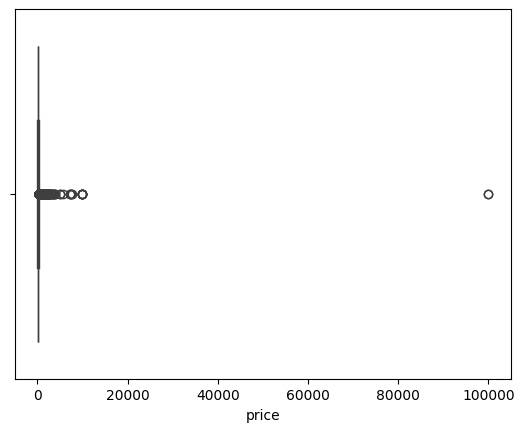

In [198]:
sns.boxplot(data=data,x='price')

<Axes: xlabel='price'>

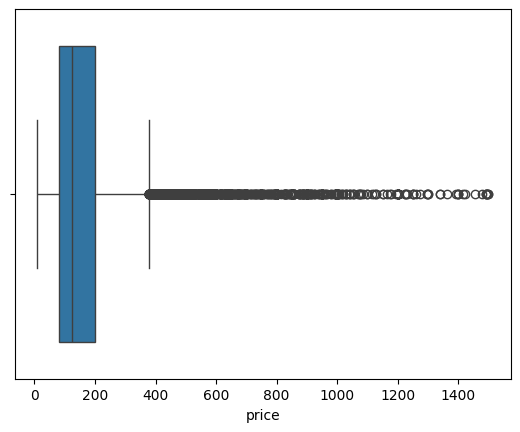

In [199]:
df=data[data['price']<1500]
sns.boxplot(data=df,x='price')

Text(0.5, 1.0, 'Price Distribution')

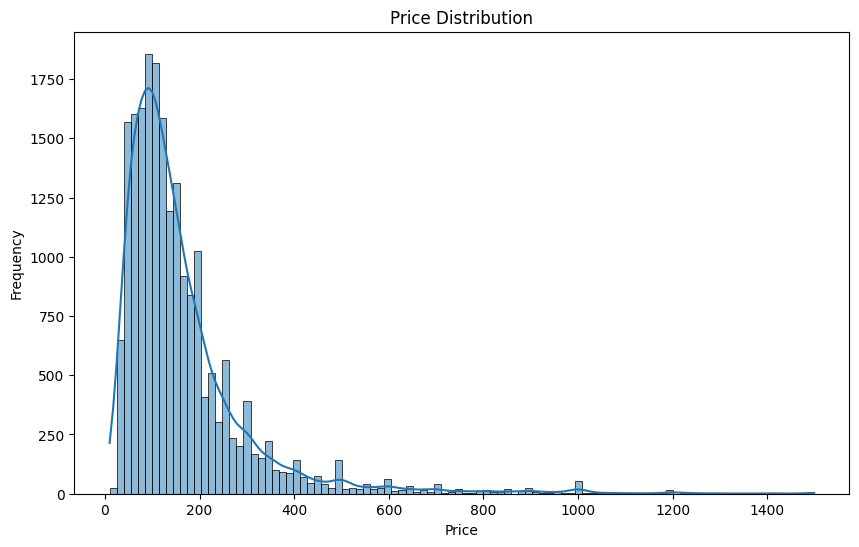

In [200]:
plt.figure(figsize=(10,6))
sns.histplot(data=df,x='price',bins=100, kde=True)
plt.ylabel('Frequency')
plt.xlabel('Price')
plt.title('Price Distribution')

Text(0.5, 0, 'Availability in 365 days')

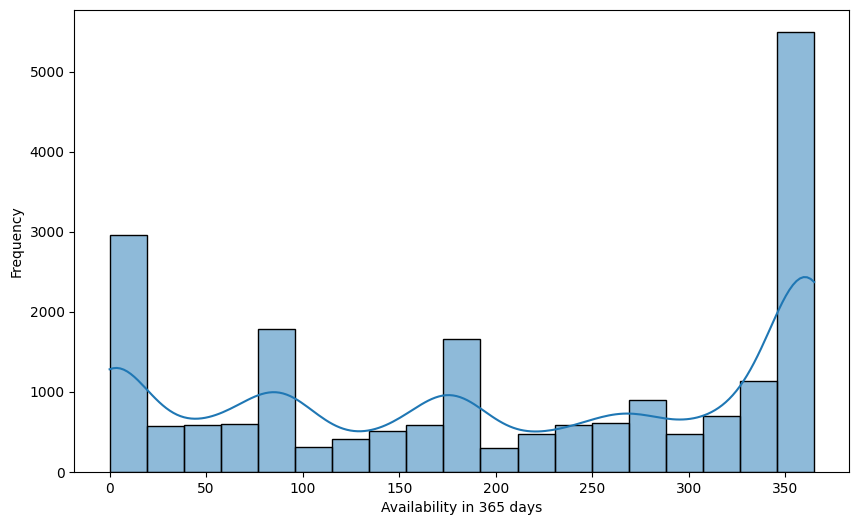

In [201]:
plt.figure(figsize=(10,6))
sns.histplot(data=df,x='availability_365', kde=True)
plt.ylabel('Frequency')
plt.xlabel('Availability in 365 days')

Text(0.5, 1.0, 'Minimum Nights Distribution')

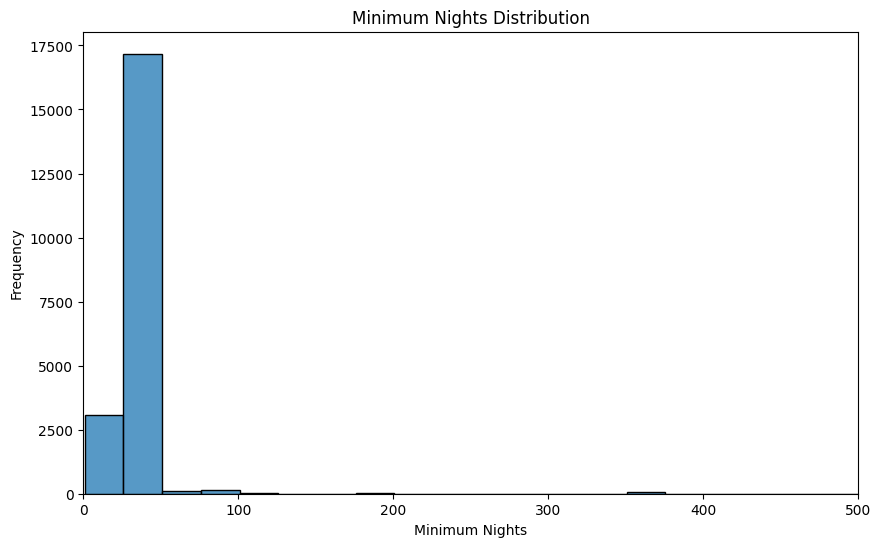

In [202]:
plt.figure(figsize=(10,6))
sns.histplot(df['minimum_nights'],bins=50)
plt.xlim(0, 500)  # zoom in on common values
plt.xlabel('Minimum Nights')
plt.ylabel('Frequency')
plt.title('Minimum Nights Distribution')

<Figure size 800x800 with 0 Axes>

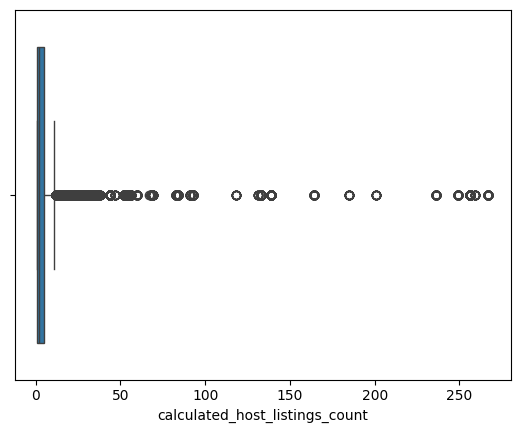

<Figure size 800x800 with 0 Axes>

In [203]:
df=df[df['calculated_host_listings_count']<300]
sns.boxplot(x=df['calculated_host_listings_count'])
plt.figure(figsize=(8,8))


Text(0.5, 1.0, 'Distribution of Beds')

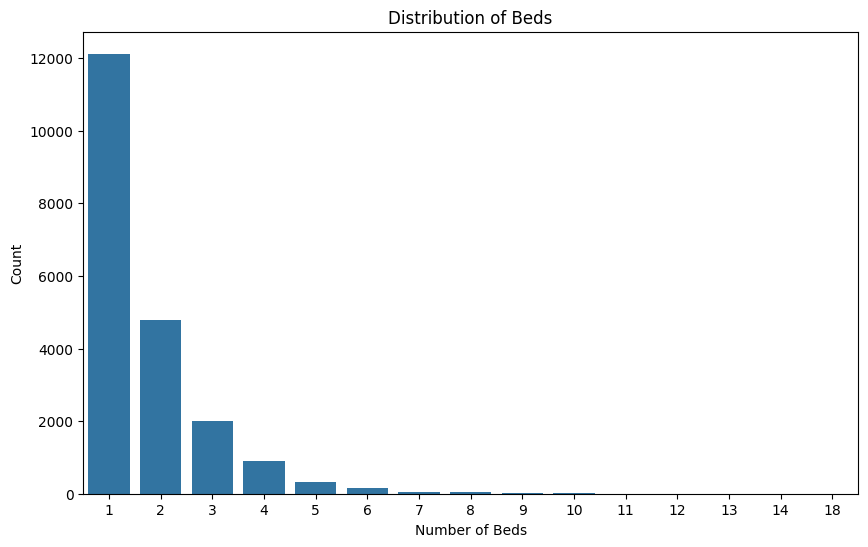

In [204]:
plt.figure(figsize=(10,6))
sns.countplot(x='beds', data=df)
plt.xlabel('Number of Beds')
plt.ylabel('Count')
plt.title('Distribution of Beds')

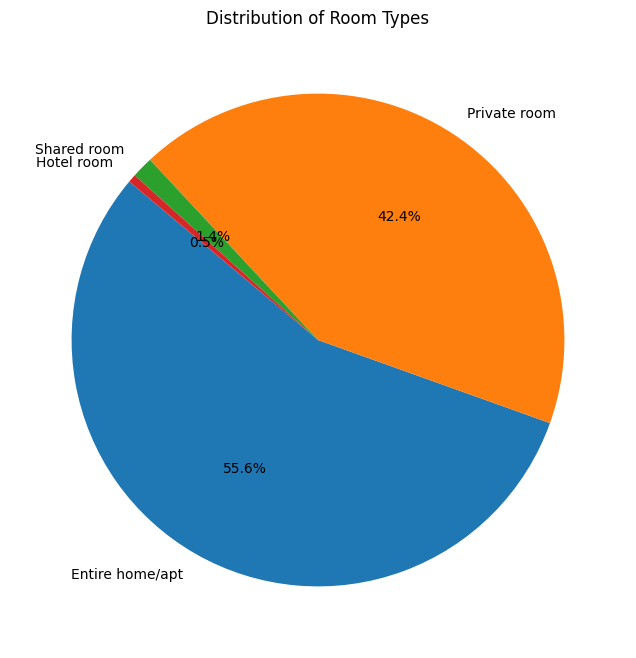

In [205]:
plt.figure(figsize=(8,8))
room_type_counts = data['room_type'].value_counts()
plt.pie(room_type_counts, labels=room_type_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Room Types')
plt.show()

Text(0.5, 1.0, 'Top 10 Neighbourhoods by Percentage')

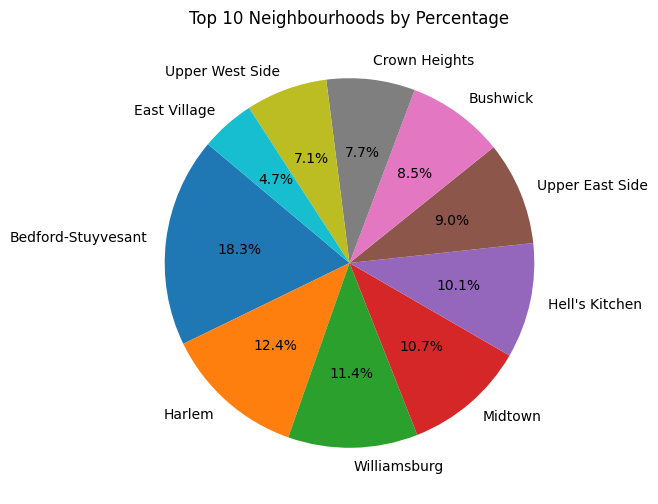

In [206]:
top_neigh = df['neighbourhood'].value_counts().nlargest(10).index
plt.figure(figsize=(12, 6))
plt.pie(df['neighbourhood'].value_counts().loc[top_neigh], labels=top_neigh, autopct='%1.1f%%', startangle=140)
plt.title('Top 10 Neighbourhoods by Percentage')


Text(0.5, 1.0, 'Average Price by Neighbourhood Group')

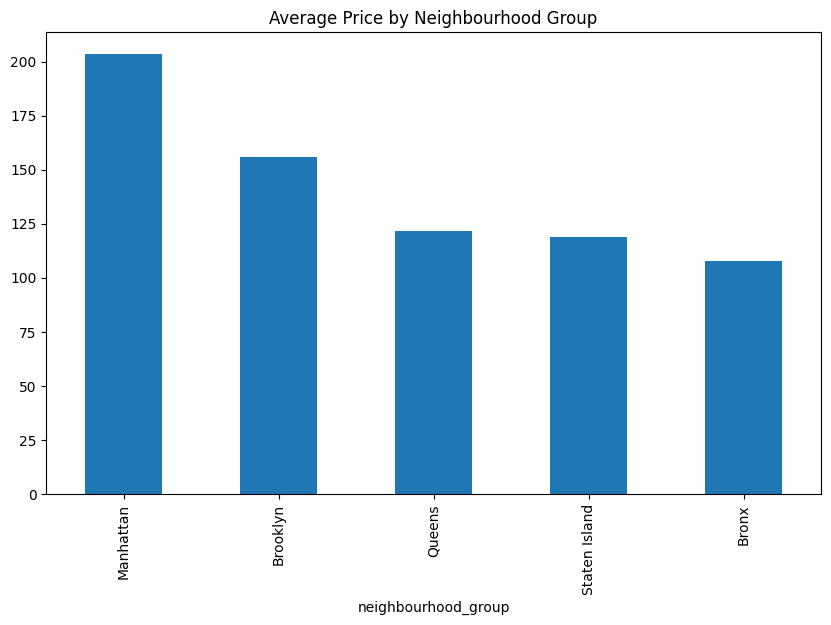

In [207]:
df.groupby(by='neighbourhood_group')['price'].mean().sort_values(ascending=False).plot(kind='bar', figsize=(10, 6))
plt.title('Average Price by Neighbourhood Group')

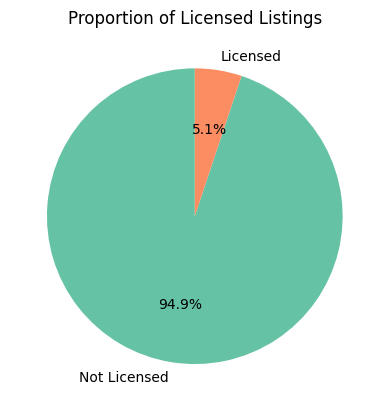

In [216]:
df['license_status'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, colors=['#66c2a5','#fc8d62'])
plt.title("Proportion of Licensed Listings")
plt.ylabel("")  # Hide Y-axis label
plt.show()


***6.Feature Engineering***

In [209]:
df['price_per_bed'] = df['price'] / df['beds']
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,...,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,rating,bedrooms,beds,baths,license_status,price_per_bed
0,1312228.0,Rental unit in Brooklyn · ★5.0 · 1 bedroom,7130382,Walter,Brooklyn,Clinton Hill,40.683710,-73.964610,Private room,55.0,...,1.0,0.0,0.0,No License,5.00,1,1,1,Not Licensed,55.0
1,45277537.0,Rental unit in New York · ★4.67 · 2 bedrooms ·...,51501835,Jeniffer,Manhattan,Hell's Kitchen,40.766610,-73.988100,Entire home/apt,144.0,...,139.0,364.0,2.0,No License,4.67,2,1,1,Not Licensed,144.0
2,971000000000000000.0,Rental unit in New York · ★4.17 · 1 bedroom · ...,528871354,Joshua,Manhattan,Chelsea,40.750764,-73.994605,Entire home/apt,187.0,...,1.0,343.0,6.0,Exempt,4.17,1,2,1,Not Licensed,93.5
3,3857863.0,Rental unit in New York · ★4.64 · 1 bedroom · ...,19902271,John And Catherine,Manhattan,Washington Heights,40.835600,-73.942500,Private room,120.0,...,2.0,363.0,12.0,No License,4.64,1,1,1,Not Licensed,120.0
4,40896611.0,Condo in New York · ★4.91 · Studio · 1 bed · 1...,61391963,Stay With Vibe,Manhattan,Murray Hill,40.751120,-73.978600,Entire home/apt,85.0,...,133.0,335.0,3.0,No License,4.91,1,1,1,Not Licensed,85.0


In [210]:
df.groupby(by='neighbourhood_group')['price_per_bed'].mean()

neighbourhood_group
Bronx             74.713639
Brooklyn         100.156922
Manhattan        137.519062
Queens            76.227951
Staten Island     67.728101
Name: price_per_bed, dtype: float64

***Bivariate Analysis***
one variable dependency on another variable

```python

<Figure size 1000x600 with 0 Axes>

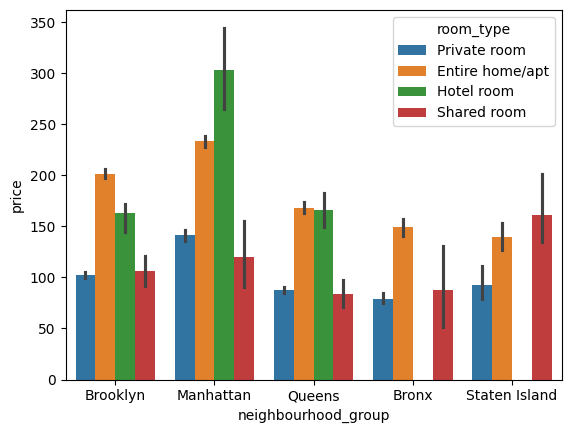

<Figure size 1000x600 with 0 Axes>

In [211]:
sns.barplot(x='neighbourhood_group', y='price', data=df,hue='room_type')
plt.figure(figsize=(10, 6))

Text(0, 0.5, 'Price')

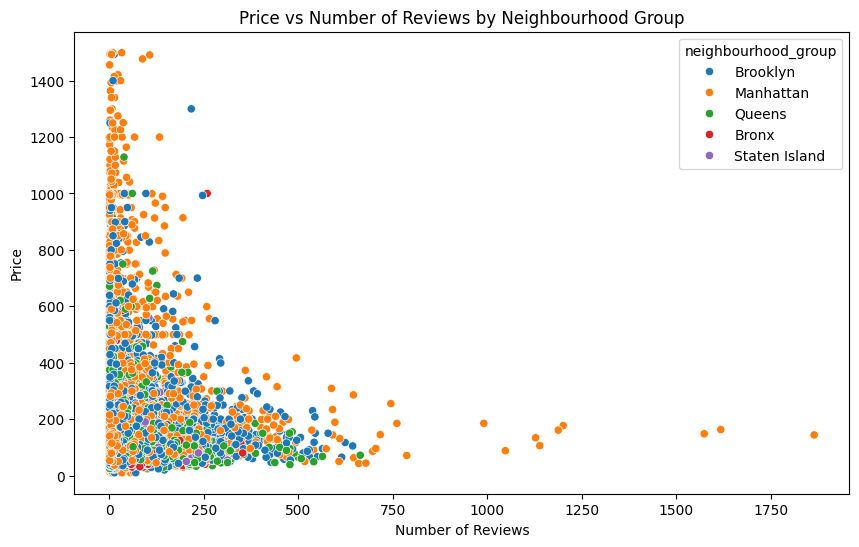

In [212]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df,x='number_of_reviews', y='price', hue='neighbourhood_group')
plt.title('Price vs Number of Reviews by Neighbourhood Group')
plt.xlabel('Number of Reviews')
plt.ylabel('Price')

c:\users\devon\appdata\local\programs\python\python39\lib\site-packages\seaborn\axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x800 with 0 Axes>

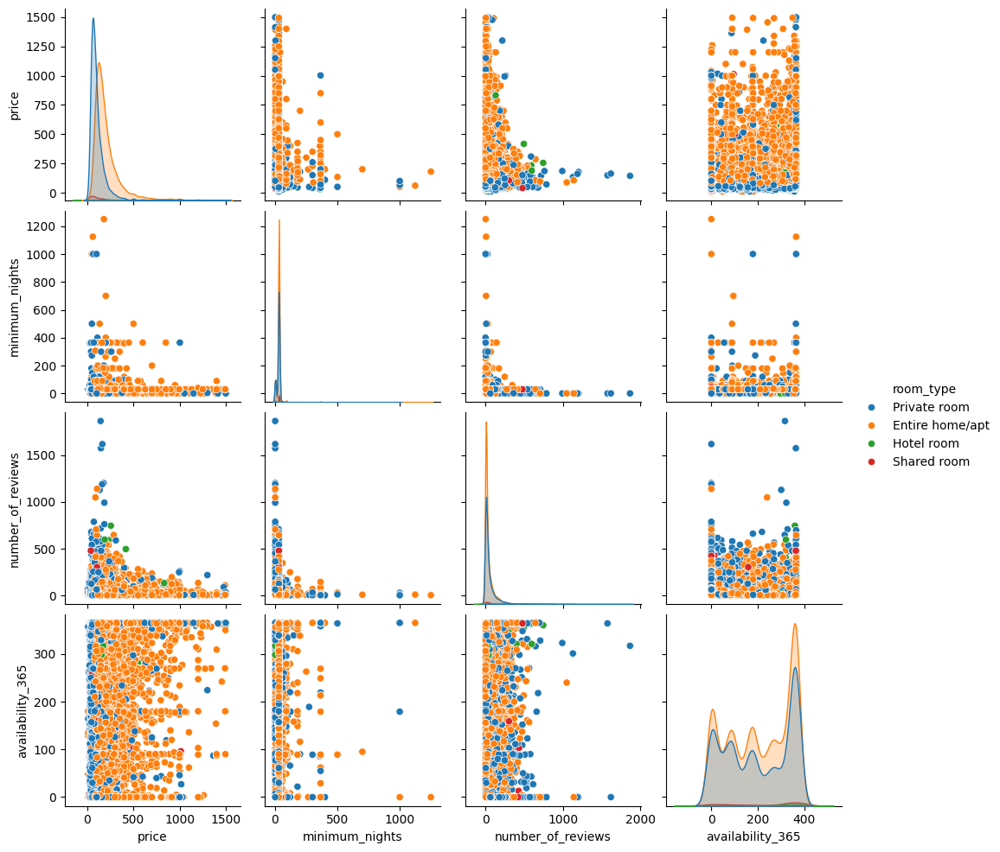

In [213]:
plt.figure(figsize=(10, 8))
sns.pairplot(data=df, vars=['price', 'minimum_nights', 'number_of_reviews', 'availability_365'], hue='room_type')

Text(0.5, 1.0, 'Geographical Distribution of Neighbourhood Groups')

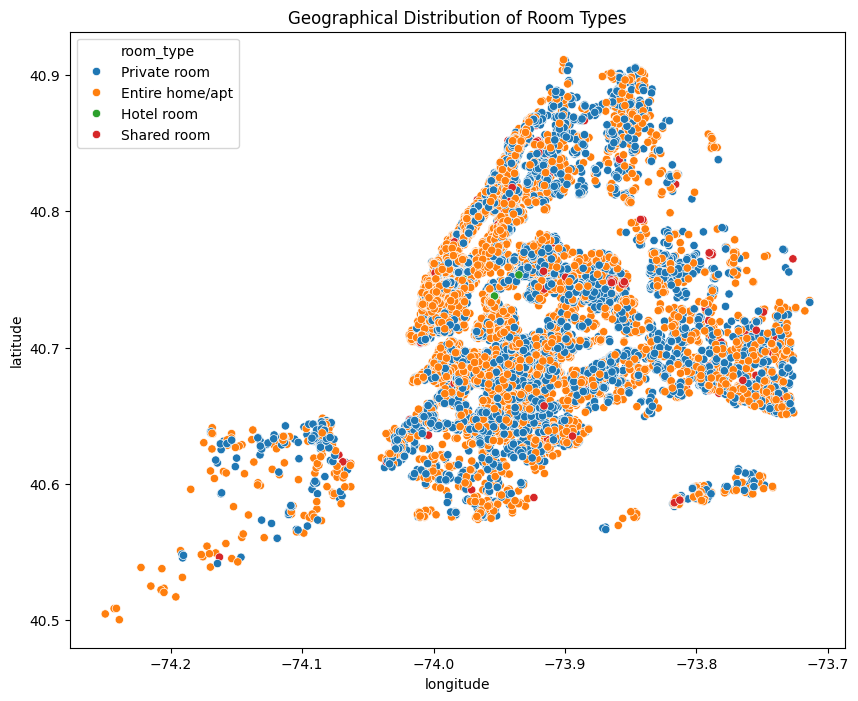

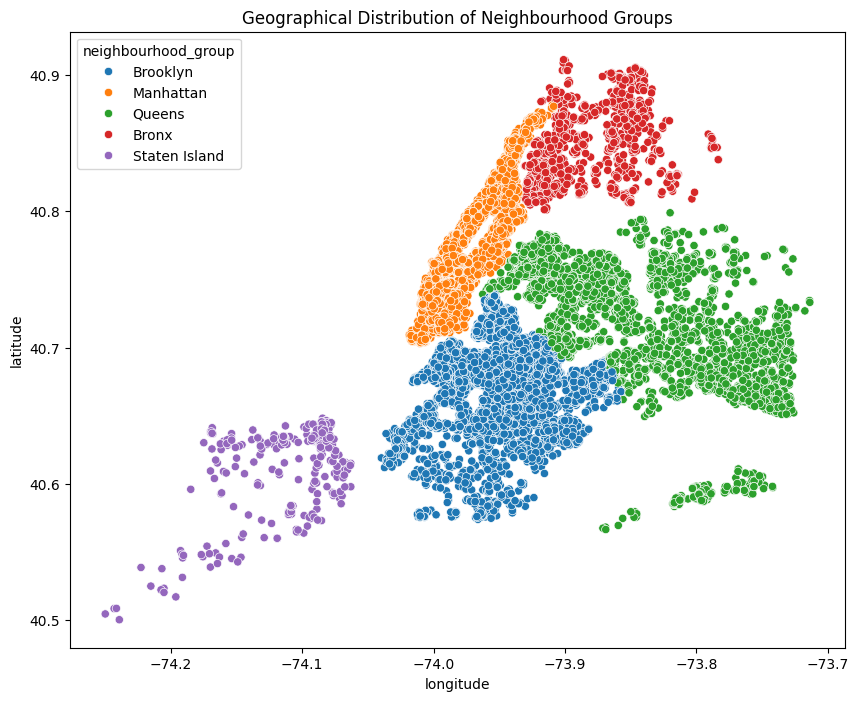

In [214]:
plt.figure(figsize=(10, 8))
sns.scatterplot(x='longitude', y='latitude', data=df, hue='room_type')

plt.title('Geographical Distribution of Room Types')
plt.figure(figsize=(10, 8))
sns.scatterplot(x='longitude', y='latitude', data=df, hue='neighbourhood_group')
plt.title('Geographical Distribution of Neighbourhood Groups')

***7.map plotting with folium***

```python

In [219]:
#import folium
import folium
from folium.plugins import MarkerCluster




In [ ]:
# Center the map on the average coordinates
center_lat = df['latitude'].mean()
center_lon = df['longitude'].mean()


In [221]:

colors = {
    'Manhattan': 'red',
    'Brooklyn': 'blue',
    'Queens': 'green',
    'Bronx': 'purple',
    'Staten Island': 'orange'
}

In [229]:
airbnb_map = folium.Map(location=[center_lat, center_lon], zoom_start=11, tiles='CartoDB positron')
# Clustered markers

marker_cluster = MarkerCluster().add_to(airbnb_map)

# Add markers to map
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors.get(row['neighbourhood_group'], 'gray'),
        fill=True,
        fill_color=colors.get(row['neighbourhood_group'], 'gray'),
        fill_opacity=0.6,
        popup=f"{row['neighbourhood']}<br>Price: ${row['price']}<br>Room: {row['room_type']}"
    ).add_to(marker_cluster)


airbnb_map

***8.Statistical Analysis***

```python

In [230]:
df.describe(include='number')


,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,rating,bedrooms,beds,baths,price_per_bed
count,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000,20461.000000
mean,40.726772,-73.938793,165.039734,28.468941,43.025805,1.270122,13.545819,205.442451,10.971800,4.733558,1.386931,1.719026,1.141147,108.472676
std,0.060514,0.061604,147.265223,33.670158,73.811219,1.912495,40.207724,135.144884,21.463448,0.267433,0.764679,1.164053,0.427567,91.423465
min,40.500314,-74.249840,10.000000,1.000000,1.000000,0.010000,1.000000,0.000000,0.000000,1.750000,1.000000,1.000000,0.000000,3.333333
25%,40.684010,-73.980500,80.000000,30.000000,4.000000,0.220000,1.000000,87.000000,1.000000,4.680000,1.000000,1.000000,1.000000,55.000000
50%,40.722600,-73.949310,125.000000,30.000000,15.000000,0.670000,2.000000,213.000000,3.000000,4.750000,1.000000,1.000000,1.000000,85.000000
75%,40.763210,-73.917020,199.000000,30.000000,50.000000,1.820000,5.000000,353.000000,15.000000,4.910000,2.000000,2.000000,1.000000,130.000000
max,40.911147,-73.713650,1499.000000,1250.000000,1865.000000,75.490000,267.000000,365.000000,1075.000000,5.000000,9.000000,18.000000,11.000000,1499.000000


Exporting The Cleaned Dataset

```python


In [237]:
df.to_csv('airbnb_cleaned.csv', index=False)
